# Capstone Project - Ticket routing automation
- Group 11, (Oct 20-Sep 21)

## Problem statement
One of the key activities of any IT function is to “Keep the lights on” to ensure there is noimpact to the Business operations. IT leverages Incident Management process to achieve theabove Objective. An incident is something that is unplanned interruption to an IT service orreduction in the quality of an IT service that affects the Users and the Business. The main goalof Incident Management process is to provide a quick fix / workarounds or solutions thatresolves the interruption and restores the service to its full capacity to ensure no businessimpact.In most of the organizations, incidents are created by various Business and IT Users, End Users/ Vendors if they have access to ticketing systems, and from the integrated monitoringsystems and tools. Assigning the incidents to the appropriate person or unit in the support team has critical importance to provide improved user satisfaction while ensuring better allocation of support resources. The assignment of incidents to appropriate IT groups is still a manual process in many of the IT organizations.Manual assignment of incidents is time consuming and requires humanefforts. There may bemistakes due to human errors and resource consumption is carried out ineffectively because ofthe misaddressing. On the other hand, manual assignment increases the response and resolution times which result in user satisfaction deterioration / poor customer service.

### Business Domain Value
In the support process, incoming incidents are analyzed and assessed by organization’s support teams to fulfill the request. In many organizations, better allocation and effective usage of the valuable support resources will directly result in substantial cost savings.Currently the incidents are created by various stakeholders (Business Users, IT Users and Monitoring Tools) within IT Service Management Tool and are assigned to Service Desk teams (L1/ L2 teams). This team will review the incidents for right ticket categorization, priorities and then carry out initial diagnosis to see if they can resolve. Around ~54% of the incidents are resolved by L1 / L2 teams. Incase L1 / L2 is unable to resolve, they will then escalate / assign the tickets to Functional teams from Applications and Infrastructure (L3 teams). Some portions of incidents are directly assigned to L3 teams by either Monitoring tools or Callers / Requestors. L3 teams will carry out detailed diagnosis and resolve the incidents. Around ~56% of incidents are resolved by Functional / L3 teams. Incase if vendor support is needed, they will reach out for their support towards incident closure.L1 / L2 needs to spend time reviewing Standard Operating Procedures (SOPs) before assigning to Functional teams (Minimum ~25-30% of incidents needs to be reviewed for SOPs before ticket assignment). 15 min is being spent for SOP review for each incident. Minimum of ~1 FTE effort needed only for incident assignment to L3 teams.

During the process of incident assignments by L1 / L2 teams to functional groups, there were multiple instances of incidents getting assigned to wrong functional groups. Around ~25% of Incidents are wrongly assigned to functional teams. Additional effort needed for Functional teams to re-assign to right functional groups. During this process, some of the incidents are in queue and not addressed timely resulting in poor customer service.Guided by powerful AI techniques that can classify incidents to right functional groups can help organizations to reduce the resolving time of the issue and can focus on more productive tasks.


## Goal
To build a ticket classifier. 



In [1]:
# Imports
import numpy as np
import pandas as pd    
import matplotlib.pyplot as plt   
%matplotlib inline
import seaborn as sns
import scipy
import scipy.stats as st

In [2]:
from google.colab import drive

In [3]:
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
import os
!ls

drive  sample_data


In [5]:
os.chdir('drive/My Drive/Colab Notebooks')

In [6]:
!ls

 17flowers
 automate-ticket-gl-grp11.ipynb
 ComputerVision-P8-Shared.ipynb
'Copy of p08-ComputerVision1-contd.ipynb'
'Data - Sarcasm Detection.'
 FlowerModel
'Flowers - Classification'
'IMDB Dataset.csv'
 input_data.xlsx
 log
 p08-ComputerVision1-contd.ipynb
 p09
 p09-ComputerVisionProj2.ipynb
 p10
 p10-NLP.ipynb
 p10-NLP-P2.ipynb
 p3-cars.csv
 p3-cars.gsheet
'Part-1 - Plant Seedling Classification Data'
 Part3-Cars
 Part4-Flower
 sarcasm_detector.h5


In [7]:
pip install wordcloud

In [8]:
pip install fasttext==0.9.2

     |████████████████████████████████| 68 kB 3.0 MB/s 
  Using cached pybind11-2.7.1-py2.py3-none-any.whl (200 kB)
  Created wheel for fasttext: filename=fasttext-0.9.2-cp37-cp37m-linux_x86_64.whl size=3090454 sha256=6fdaab2f2b94e883a1dfac61dcb33bb9dbe37e139d888d2ed3a640fd9f9eaafb
  Stored in directory: /root/.cache/pip/wheels/4e/ca/bf/b020d2be95f7641801a6597a29c8f4f19e38f9c02a345bab9b
Successfully built fasttext


In [9]:
tickets = pd.read_excel('input_data.xlsx')

In [10]:
tickets.head()

,Short description,Description,Caller,Assignment group
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0
1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0


In [11]:
tickets.head(20)

,Short description,Description,Caller,Assignment group
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0
1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0
5,unable to log in to engineering tool and skype,unable to log in to engineering tool and skype,eflahbxn ltdgrvkz,GRP_0
6,event: critical:HostName_221.company.com the v...,event: critical:HostName_221.company.com the v...,jyoqwxhz clhxsoqy,GRP_1
7,ticket_no1550391- employment status - new non-...,ticket_no1550391- employment status - new non-...,eqzibjhw ymebpoih,GRP_0
8,unable to disable add ins on outlook,unable to disable add ins on outlook,mdbegvct dbvichlg,GRP_0
9,ticket update on inplant_874773,ticket update on inplant_874773,fumkcsji sarmtlhy,GRP_0


In [12]:
tickets.describe()

,Short description,Description,Caller,Assignment group
count,8492,8499,8500,8500
unique,7481,7817,2950,74
top,password reset,the,bpctwhsn kzqsbmtp,GRP_0
freq,38,56,810,3976


In [13]:
tickets.isna().sum()

Short description    8
Description          1
Caller               0
Assignment group     0
dtype: int64

In [14]:
tickets.dropna(inplace = True)

In [15]:
tickets.isna().sum()

Short description    0
Description          0
Caller               0
Assignment group     0
dtype: int64

In [16]:
tickets['Caller'].unique()

array(['spxjnwir pjlcoqds', 'hmjdrvpb komuaywn', 'eylqgodm ybqkwiam', ...,
       'bjitvswa yrmugfnq', 'oybwdsgx oxyhwrfz', 'kqvbrspl jyzoklfx'],
      dtype=object)

In [17]:
tickets['Caller'].value_counts()

bpctwhsn kzqsbmtp    810
ZkBogxib QsEJzdZO    151
fumkcsji sarmtlhy    134
rbozivdq gmlhrtvp     87
rkupnshb gsmzfojw     71
                    ... 
dubpgacz kjzhilng      1
rzxfgmcu xprwayoc      1
hctajofe qgrkcxyt      1
ogfjbrlw nwakldmx      1
uojdnrvs amchenrg      1
Name: Caller, Length: 2948, dtype: int64

In [18]:
# Content in caller seems to be gibberish and does not make sense at all. We potentially can drop this column. 

In [19]:
tickets['Assignment group'].value_counts()

GRP_0     3968
GRP_8      661
GRP_24     289
GRP_12     257
GRP_9      252
          ... 
GRP_73       1
GRP_64       1
GRP_35       1
GRP_61       1
GRP_67       1
Name: Assignment group, Length: 74, dtype: int64

In [20]:
tickets.size


33964

In [21]:
groups_freq = pd.DataFrame.from_dict(dict(tickets['Assignment group'].value_counts()), orient='index', columns=['frequency'])

In [22]:
groups_freq.head(20)

,frequency
GRP_0,3968
GRP_8,661
GRP_24,289
GRP_12,257
GRP_9,252
GRP_2,241
GRP_19,215
GRP_3,200
GRP_6,184
GRP_13,145


In [23]:
# Beyod 20 groups remaining 54 groups contain less than 80 tickets per group. This data set is heavily skewed on certain groups. 

In [24]:
groups_freq.tail(30)

,frequency
GRP_44,15
GRP_36,15
GRP_50,14
GRP_65,11
GRP_53,11
GRP_52,9
GRP_55,8
GRP_51,8
GRP_49,6
GRP_46,6


In [25]:
# bottom 30 groups barely have any significant tickets to affect any learning here. 

In [26]:
tickets

,Short description,Description,Caller,Assignment group
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0
1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0
...,...,...,...,...
8495,emails not coming in from zz mail,\r\n\r\nreceived from: avglmrts.vhqmtiua@gmail...,avglmrts vhqmtiua,GRP_29
8496,telephony_software issue,telephony_software issue,rbozivdq gmlhrtvp,GRP_0
8497,vip2: windows password reset for tifpdchb pedx...,vip2: windows password reset for tifpdchb pedx...,oybwdsgx oxyhwrfz,GRP_0
8498,machine nÃ£o estÃ¡ funcionando,i am unable to access the machine utilities to...,ufawcgob aowhxjky,GRP_62


In [27]:
groups_freq['percentage'] = (groups_freq['frequency'] / groups_freq['frequency'].sum())*100
groups_freq.head(30)

,frequency,percentage
GRP_0,3968,46.731834
GRP_8,661,7.784713
GRP_24,289,3.403604
GRP_12,257,3.026734
GRP_9,252,2.967848
GRP_2,241,2.838299
GRP_19,215,2.532093
GRP_3,200,2.355435
GRP_6,184,2.167000
GRP_13,145,1.707690


In [28]:
groups_freq['cum percent'] = groups_freq['percentage'].cumsum(axis = 0)

In [29]:
groups_freq.head(45)

,frequency,percentage,cum percent
GRP_0,3968,46.731834,46.731834
GRP_8,661,7.784713,54.516547
GRP_24,289,3.403604,57.920151
GRP_12,257,3.026734,60.946885
GRP_9,252,2.967848,63.914733
GRP_2,241,2.838299,66.753033
GRP_19,215,2.532093,69.285125
GRP_3,200,2.355435,71.640561
GRP_6,184,2.167000,73.807561
GRP_13,145,1.707690,75.515251


In [30]:
# It seems 35 groups cover for ~96% of tickets. Rest 39 contribute to only 4% of the trips. 
# If we ignore all entries below 35 frequency then we have a coverage of ~95% of the tickets. 


In [31]:
groups_filtered = groups_freq[groups_freq['frequency'] >= 35]

In [32]:

len(groups_filtered)

32

In [33]:
grp_list = list(groups_filtered.index)

In [34]:
grp_list

['GRP_0',
 'GRP_8',
 'GRP_24',
 'GRP_12',
 'GRP_9',
 'GRP_2',
 'GRP_19',
 'GRP_3',
 'GRP_6',
 'GRP_13',
 'GRP_10',
 'GRP_5',
 'GRP_14',
 'GRP_25',
 'GRP_33',
 'GRP_4',
 'GRP_29',
 'GRP_18',
 'GRP_16',
 'GRP_17',
 'GRP_31',
 'GRP_7',
 'GRP_34',
 'GRP_26',
 'GRP_40',
 'GRP_28',
 'GRP_41',
 'GRP_15',
 'GRP_30',
 'GRP_42',
 'GRP_20',
 'GRP_45']

In [35]:
tickets_filtered = tickets[tickets['Assignment group'].isin(grp_list)]

In [36]:
tickets_filtered.describe()

,Short description,Description,Caller,Assignment group
count,8042,8042,8042,8042
unique,7067,7378,2864,32
top,password reset,the,bpctwhsn kzqsbmtp,GRP_0
freq,38,56,784,3968


In [37]:
tickets_filtered['Assignment group'].value_counts()

GRP_0     3968
GRP_8      661
GRP_24     289
GRP_12     257
GRP_9      252
GRP_2      241
GRP_19     215
GRP_3      200
GRP_6      184
GRP_13     145
GRP_10     140
GRP_5      129
GRP_14     118
GRP_25     116
GRP_33     107
GRP_4      100
GRP_29      97
GRP_18      88
GRP_16      85
GRP_17      81
GRP_31      69
GRP_7       68
GRP_34      61
GRP_26      56
GRP_40      45
GRP_28      44
GRP_41      40
GRP_15      39
GRP_30      39
GRP_42      37
GRP_20      36
GRP_45      35
Name: Assignment group, dtype: int64

In [89]:
# Data cleaning functions

def remove_spaces_and_tabs(df, col_name):
  df[col_name] = df[col_name].str.strip()
  df[col_name] = df[col_name].replace(r"\\t|\\n|\\r", "\t|\n|\r", regex=True)
  df[col_name] = df[col_name].replace('\s+', ' ', regex=True)

def remove_digits(df, col_name):
  df[col_name] = df[col_name].replace('\d+', '', regex=True)

def lower_case(df, col_name):
  df[col_name] = df[col_name].str.lower()

spec_chars = ["!",'"',"#","%","&","'","(",")",
              "*","+",",","-",".","/",":",";","<",
              "=",">","?","@","[","\\","]","^","_",
              "`","{","|","}","~","–"]
def remove_special_chars(df, col_name):
  for char in spec_chars:
    df[col_name] = df[col_name].str.replace(char, ' ')

def clean_data(df, col_name):
  remove_spaces_and_tabs(df, col_name)
  remove_special_chars(df, col_name)
  remove_spaces_and_tabs(df, col_name)
  remove_digits(df, col_name)
  lower_case(df, col_name)



In [90]:
tickets_filtered.head(10)

,Short description,Description,Caller,Assignment group
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0
1,outlook,received from: hmjdrvpb.komuaywn@gmail.com hel...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,received from: eylqgodm.ybqkwiam@gmail.com hi ...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0
5,unable to log in to engineering tool and skype,unable to log in to engineering tool and skype,eflahbxn ltdgrvkz,GRP_0
7,ticket_no- employment status - new non-employe...,ticket_no- employment status - new non-employe...,eqzibjhw ymebpoih,GRP_0
8,unable to disable add ins on outlook,unable to disable add ins on outlook,mdbegvct dbvichlg,GRP_0
9,ticket update on inplant_,ticket update on inplant_,fumkcsji sarmtlhy,GRP_0
10,engineering tool says not connected and unable...,engineering tool says not connected and unable...,badgknqs xwelumfz,GRP_0


In [91]:
tickets_filtered['Caller'].value_counts()

bpctwhsn kzqsbmtp    784
ZkBogxib QsEJzdZO    142
fumkcsji sarmtlhy    133
rbozivdq gmlhrtvp     87
rkupnshb gsmzfojw     66
                    ... 
rfvmeyho qgtxjsdc      1
hiysxgwf vqdbtexf      1
sdlixwmb zvygmnco      1
uyjglskh lhurepnw      1
oybwdsgx oxyhwrfz      1
Name: Caller, Length: 2864, dtype: int64

In [92]:
clean_data(tickets_filtered, 'Description')
clean_data(tickets_filtered, 'Short description')


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation:

In [93]:
tickets_filtered

,Short description,Description,Caller,Assignment group
0,login issue,verified user details employee manager name ch...,spxjnwir pjlcoqds,GRP_0
1,outlook,received from hmjdrvpb komuaywn gmail com hell...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,received from eylqgodm ybqkwiam gmail com hi i...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0
...,...,...,...,...
8493,erp fi ob two accounts to be added,i am sorry i have another two accounts that ne...,ipwjorsc uboapexr,GRP_10
8494,tablet needs reimaged due to multiple issues w...,tablet needs reimaged due to multiple issues w...,cpmaidhj elbaqmtp,GRP_3
8495,emails not coming in from zz mail,received from avglmrts vhqmtiua gmail com good...,avglmrts vhqmtiua,GRP_29
8496,telephony software issue,telephony software issue,rbozivdq gmlhrtvp,GRP_0


In [94]:
tickets_filtered

,Short description,Description,Caller,Assignment group
0,login issue,verified user details employee manager name ch...,spxjnwir pjlcoqds,GRP_0
1,outlook,received from hmjdrvpb komuaywn gmail com hell...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,received from eylqgodm ybqkwiam gmail com hi i...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0
...,...,...,...,...
8493,erp fi ob two accounts to be added,i am sorry i have another two accounts that ne...,ipwjorsc uboapexr,GRP_10
8494,tablet needs reimaged due to multiple issues w...,tablet needs reimaged due to multiple issues w...,cpmaidhj elbaqmtp,GRP_3
8495,emails not coming in from zz mail,received from avglmrts vhqmtiua gmail com good...,avglmrts vhqmtiua,GRP_29
8496,telephony software issue,telephony software issue,rbozivdq gmlhrtvp,GRP_0


In [95]:
tickets_filtered['eq'] = tickets_filtered.apply(lambda x: x['Short description'] == x['Description'], axis=1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [96]:
tickets_filtered['eq'].value_counts()

False    5138
True     2904
Name: eq, dtype: int64

In [97]:
tickets_filtered[tickets_filtered['eq']]

,Short description,Description,Caller,Assignment group,eq
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0,True
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,True
5,unable to log in to engineering tool and skype,unable to log in to engineering tool and skype,eflahbxn ltdgrvkz,GRP_0,True
7,ticket no employment status new non employee e...,ticket no employment status new non employee e...,eqzibjhw ymebpoih,GRP_0,True
8,unable to disable add ins on outlook,unable to disable add ins on outlook,mdbegvct dbvichlg,GRP_0,True
...,...,...,...,...,...
8489,account locked,account locked,sdvlxbfe ptnahjkw,GRP_0,True
8492,hr tool etime option not visitble,hr tool etime option not visitble,tmopbken ibzougsd,GRP_0,True
8494,tablet needs reimaged due to multiple issues w...,tablet needs reimaged due to multiple issues w...,cpmaidhj elbaqmtp,GRP_3,True
8496,telephony software issue,telephony software issue,rbozivdq gmlhrtvp,GRP_0,True


In [98]:
tickets_filtered['substr'] = tickets_filtered.apply(lambda x: x['Short description'] in x['Description'], axis=1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [99]:
tickets_filtered[tickets_filtered['substr']]

,Short description,Description,Caller,Assignment group,eq,substr
0,login issue,verified user details employee manager name ch...,spxjnwir pjlcoqds,GRP_0,False,True
1,outlook,received from hmjdrvpb komuaywn gmail com hell...,hmjdrvpb komuaywn,GRP_0,False,True
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0,True,True
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,True,True
5,unable to log in to engineering tool and skype,unable to log in to engineering tool and skype,eflahbxn ltdgrvkz,GRP_0,True,True
...,...,...,...,...,...,...
8489,account locked,account locked,sdvlxbfe ptnahjkw,GRP_0,True,True
8492,hr tool etime option not visitble,hr tool etime option not visitble,tmopbken ibzougsd,GRP_0,True,True
8494,tablet needs reimaged due to multiple issues w...,tablet needs reimaged due to multiple issues w...,cpmaidhj elbaqmtp,GRP_3,True,True
8496,telephony software issue,telephony software issue,rbozivdq gmlhrtvp,GRP_0,True,True


In [100]:
tickets_filtered[tickets_filtered['substr']][tickets_filtered['eq'] != True]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


,Short description,Description,Caller,Assignment group,eq,substr
0,login issue,verified user details employee manager name ch...,spxjnwir pjlcoqds,GRP_0,False,True
1,outlook,received from hmjdrvpb komuaywn gmail com hell...,hmjdrvpb komuaywn,GRP_0,False,True
16,unable to login to company vpn,received from xyz company com hi i am unable t...,chobktqj qdamxfuc,GRP_0,False,True
31,reset users,hi please reset users password client id usern...,qcehailo wqynckxg,GRP_0,False,True
47,job job failed in job scheduler at,received from monitoring tool company com job ...,bpctwhsn kzqsbmtp,GRP_6,False,True
...,...,...,...,...,...,...
8467,hi it help team please unblock my new company ...,from ntydihzo aeptfbgs sent friday august am t...,ntydihzo aeptfbgs,GRP_0,False,True
8470,please review your recent ticketing tool ticke...,from mikhghytr wafglhdrhjop sent thursday augu...,azxhejvq fyemlavd,GRP_16,False,True
8471,ç”µè„‘å¼€æœºå¼€ä¸å‡ºæ¥,to å°è´ºï¼œæ—©ä¸šç”µè„‘å¼€æœºå¼€ä¸å‡ºæ¥,xqyjztnm onfusvlz,GRP_30,False,True
8483,fw case id ref case ref others,from pacvbetl yptglhoe sent thursday august pm...,pacvbetl yptglhoe,GRP_0,False,True


In [103]:
# Hence, there are 4936 rows where short description is substr and out of them 2032 are the ones where short and long descriptions are not equal

In [104]:
# Check if having equality has any effect on group distribution

In [105]:
tickets_filtered[tickets_filtered['eq'] != True]['Assignment group'].value_counts()

GRP_0     1862
GRP_8      606
GRP_9      245
GRP_2      210
GRP_12     198
GRP_6      181
GRP_19     172
GRP_13     137
GRP_10     132
GRP_5      128
GRP_3      104
GRP_25      97
GRP_29      93
GRP_4       90
GRP_18      84
GRP_14      83
GRP_33      80
GRP_16      77
GRP_17      77
GRP_7       60
GRP_34      45
GRP_24      44
GRP_26      44
GRP_40      44
GRP_41      39
GRP_15      37
GRP_31      34
GRP_45      33
GRP_20      29
GRP_42      28
GRP_30      23
GRP_28      22
Name: Assignment group, dtype: int64

In [106]:
tickets_filtered[tickets_filtered['eq']]['Assignment group'].value_counts()

GRP_0     2106
GRP_24     245
GRP_3       96
GRP_12      59
GRP_8       55
GRP_19      43
GRP_31      35
GRP_14      35
GRP_2       31
GRP_33      27
GRP_28      22
GRP_25      19
GRP_34      16
GRP_30      16
GRP_26      12
GRP_4       10
GRP_42       9
GRP_7        8
GRP_16       8
GRP_13       8
GRP_10       8
GRP_9        7
GRP_20       7
GRP_29       4
GRP_17       4
GRP_18       4
GRP_6        3
GRP_15       2
GRP_45       2
GRP_40       1
GRP_5        1
GRP_41       1
Name: Assignment group, dtype: int64

In [107]:
# Similarly check for substr feature

In [108]:
tickets_filtered[tickets_filtered['substr']]['Assignment group'].value_counts()

GRP_0     2659
GRP_8      487
GRP_24     263
GRP_9      209
GRP_6      132
GRP_12     130
GRP_3      124
GRP_5      115
GRP_19      88
GRP_10      82
GRP_2       82
GRP_14      63
GRP_31      46
GRP_33      44
GRP_4       37
GRP_13      37
GRP_25      37
GRP_18      35
GRP_28      29
GRP_29      29
GRP_7       27
GRP_16      26
GRP_26      25
GRP_30      24
GRP_34      21
GRP_42      18
GRP_40      15
GRP_45      15
GRP_20      14
GRP_41      11
GRP_15       8
GRP_17       4
Name: Assignment group, dtype: int64

In [109]:
tickets_filtered[tickets_filtered['substr'] != True]['Assignment group'].value_counts()

GRP_0     1309
GRP_8      174
GRP_2      159
GRP_19     127
GRP_12     127
GRP_13     108
GRP_25      79
GRP_17      77
GRP_3       76
GRP_29      68
GRP_33      63
GRP_4       63
GRP_16      59
GRP_10      58
GRP_14      55
GRP_18      53
GRP_6       52
GRP_9       43
GRP_7       41
GRP_34      40
GRP_26      31
GRP_15      31
GRP_40      30
GRP_41      29
GRP_24      26
GRP_31      23
GRP_20      22
GRP_45      20
GRP_42      19
GRP_30      15
GRP_28      15
GRP_5       14
Name: Assignment group, dtype: int64

In [110]:
# Doesn't look like any association as such for equality and substring feature. But what we can do is where strings are not equal or substr let's club the string content to 
# make sure that both can be considered for feature gathering. 

In [111]:
tickets_comb = tickets_filtered.copy()
# Club short and long description in long description itself. 
tickets_comb.loc[tickets_comb['substr'] != True, 'Description'] = tickets_comb['Short description'] + " "+ tickets_comb['Description']

In [112]:
tickets_comb.head(10)

,Short description,Description,Caller,Assignment group,eq,substr
0,login issue,verified user details employee manager name ch...,spxjnwir pjlcoqds,GRP_0,False,True
1,outlook,received from hmjdrvpb komuaywn gmail com hell...,hmjdrvpb komuaywn,GRP_0,False,True
2,cant log in to vpn,cant log in to vpn received from eylqgodm ybqk...,eylqgodm ybqkwiam,GRP_0,False,False
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0,True,True
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,True,True
5,unable to log in to engineering tool and skype,unable to log in to engineering tool and skype,eflahbxn ltdgrvkz,GRP_0,True,True
7,ticket no employment status new non employee e...,ticket no employment status new non employee e...,eqzibjhw ymebpoih,GRP_0,True,True
8,unable to disable add ins on outlook,unable to disable add ins on outlook,mdbegvct dbvichlg,GRP_0,True,True
9,ticket update on inplant,ticket update on inplant,fumkcsji sarmtlhy,GRP_0,True,True
10,engineering tool says not connected and unable...,engineering tool says not connected and unable...,badgknqs xwelumfz,GRP_0,True,True


Entry 2 shows merge happened when not equal
and entry 4 represent did not happen when not substre

In [113]:
#Drop Short description, eq and substr
tickets_comb.drop(columns=['Short description', 'substr', 'eq'],axis=1, inplace=True)


In [114]:
tickets_comb.head(10)

,Description,Caller,Assignment group
0,verified user details employee manager name ch...,spxjnwir pjlcoqds,GRP_0
1,received from hmjdrvpb komuaywn gmail com hell...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn received from eylqgodm ybqk...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,owlgqjme qhcozdfx,GRP_0
5,unable to log in to engineering tool and skype,eflahbxn ltdgrvkz,GRP_0
7,ticket no employment status new non employee e...,eqzibjhw ymebpoih,GRP_0
8,unable to disable add ins on outlook,mdbegvct dbvichlg,GRP_0
9,ticket update on inplant,fumkcsji sarmtlhy,GRP_0
10,engineering tool says not connected and unable...,badgknqs xwelumfz,GRP_0


In [115]:
tickets_comb['Caller'].value_counts()

bpctwhsn kzqsbmtp    784
ZkBogxib QsEJzdZO    142
fumkcsji sarmtlhy    133
rbozivdq gmlhrtvp     87
rkupnshb gsmzfojw     66
                    ... 
rfvmeyho qgtxjsdc      1
hiysxgwf vqdbtexf      1
sdlixwmb zvygmnco      1
uyjglskh lhurepnw      1
oybwdsgx oxyhwrfz      1
Name: Caller, Length: 2864, dtype: int64

In [116]:
tickets_comb[tickets_comb['Caller'] == "bpctwhsn kzqsbmtp"].value_counts()

Description                                                                                                                              Caller             Assignment group
received from monitoring tool company com job job failed in job scheduler at                                                             bpctwhsn kzqsbmtp  GRP_8               185
                                                                                                                                                            GRP_9               127
                                                                                                                                                            GRP_6                48
received from monitoring tool company com job hr payroll na u failed in job scheduler at                                                 bpctwhsn kzqsbmtp  GRP_10               36
received from monitoring tool company com job pp eu tool netch ap failed in job scheduler at               

In [121]:
# It seems this caller is receiving monitoring tool emails which is being logged as errors. 

In [122]:
tickets_comb[tickets_comb['Caller'] == "ZkBogxib QsEJzdZO"].value_counts()

Description                                                                                                                                                        Caller             Assignment group
received from monitoring tool company com abended job in job scheduler job at                                                                                      ZkBogxib QsEJzdZO  GRP_9               30
                                                                                                                                                                                      GRP_8               25
                                                                                                                                                                                      GRP_6               14
received from monitoring tool company com abended job in job scheduler sid cold at                                                                                 ZkBogxib QsEJzdZO  GRP_

In [123]:
# same with other callers. Seems like an irrelevant column. let's drop it as well. 

In [124]:
tickets_comb.drop(columns=['Caller'], axis=1, inplace=True)

In [125]:
tickets_comb.head(10)

,Description,Assignment group
0,verified user details employee manager name ch...,GRP_0
1,received from hmjdrvpb komuaywn gmail com hell...,GRP_0
2,cant log in to vpn received from eylqgodm ybqk...,GRP_0
3,unable to access hr tool page,GRP_0
4,skype error,GRP_0
5,unable to log in to engineering tool and skype,GRP_0
7,ticket no employment status new non employee e...,GRP_0
8,unable to disable add ins on outlook,GRP_0
9,ticket update on inplant,GRP_0
10,engineering tool says not connected and unable...,GRP_0


In [126]:
# let's keep this data sane and copy in different data frame to run algorithms
tickets_comb_modelling = tickets_comb.copy()

In [127]:
# Searched for identifying the lnguage of the text, as on scanning excel sheet I had come across some other language cahracters
# Reference: https://stackoverflow.com/questions/39142778/python-how-to-determine-the-language
# Using fasttext to detect language https://amitness.com/2019/07/identify-text-language-python/

In [129]:
import fasttext

# pretrained model from :: https://dl.fbaipublicfiles.com/fasttext/supervised-models/lid.176.bin
PRETRAINED_MODEL_PATH = 'lid.176.bin'
lang_detect_model = fasttext.load_model(PRETRAINED_MODEL_PATH)

def predict_lang(sentence):
    detected_lang = lang_detect_model.predict(sentence)[0]
    detected_lang = detected_lang[0].replace('__label__', '')
    return detected_lang;

tickets_comb_modelling['lang_predict'] = tickets_comb_modelling['Description'].apply(lambda v: predict_lang(v))
tickets_comb_modelling.head()

,Description,Assignment group,lang_predict
0,verified user details employee manager name ch...,GRP_0,en
1,received from hmjdrvpb komuaywn gmail com hell...,GRP_0,en
2,cant log in to vpn received from eylqgodm ybqk...,GRP_0,en
3,unable to access hr tool page,GRP_0,en
4,skype error,GRP_0,ja


In [130]:
tickets_comb_modelling[tickets_comb_modelling['lang_predict'] != 'en']

,Description,Assignment group,lang_predict
4,skype error,GRP_0,ja
39,call for ecwtrjnq jpecxuty,GRP_0,eo
51,call for ecwtrjnq jpecxuty,GRP_0,eo
126,blank call gso,GRP_0,hr
223,probleme mit bluescreen hallo es ist erneut pa...,GRP_24,de
...,...,...,...
8439,der drucker fã¼r die ups lapels druckt nicht r...,GRP_33,de
8457,æ— æ³•ç™»é™†hr toolè€ƒå‹¤ç³»ç»ÿ æ˜¾ç¤ºjavaæ’ä...,GRP_30,zh
8465,vpn è¿žæž¥ä¸ä¸š vpnè¿žä¸ä¸šï¼œè¯·è½¬ç»™ è´ºæ...,GRP_30,cs
8467,from ntydihzo aeptfbgs sent friday august am t...,GRP_0,de


In [131]:
# We have 612 non english rows. Some content does seem to be english in them though. But some is truly non-english characters. 

In [132]:
tickets_comb_modelling

,Description,Assignment group,lang_predict
0,verified user details employee manager name ch...,GRP_0,en
1,received from hmjdrvpb komuaywn gmail com hell...,GRP_0,en
2,cant log in to vpn received from eylqgodm ybqk...,GRP_0,en
3,unable to access hr tool page,GRP_0,en
4,skype error,GRP_0,ja
...,...,...,...
8493,erp fi ob two accounts to be added i am sorry ...,GRP_10,en
8494,tablet needs reimaged due to multiple issues w...,GRP_3,en
8495,emails not coming in from zz mail received fro...,GRP_29,en
8496,telephony software issue,GRP_0,en


In [133]:
# Let's keep purely english 
tickets_english = tickets_comb_modelling[tickets_comb_modelling['lang_predict'] == 'en']

In [134]:
tickets_english

,Description,Assignment group,lang_predict
0,verified user details employee manager name ch...,GRP_0,en
1,received from hmjdrvpb komuaywn gmail com hell...,GRP_0,en
2,cant log in to vpn received from eylqgodm ybqk...,GRP_0,en
3,unable to access hr tool page,GRP_0,en
5,unable to log in to engineering tool and skype,GRP_0,en
...,...,...,...
8493,erp fi ob two accounts to be added i am sorry ...,GRP_10,en
8494,tablet needs reimaged due to multiple issues w...,GRP_3,en
8495,emails not coming in from zz mail received fro...,GRP_29,en
8496,telephony software issue,GRP_0,en


In [135]:
tickets_english.drop(columns=['lang_predict'], axis=1, inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [136]:
tickets_english

,Description,Assignment group
0,verified user details employee manager name ch...,GRP_0
1,received from hmjdrvpb komuaywn gmail com hell...,GRP_0
2,cant log in to vpn received from eylqgodm ybqk...,GRP_0
3,unable to access hr tool page,GRP_0
5,unable to log in to engineering tool and skype,GRP_0
...,...,...
8493,erp fi ob two accounts to be added i am sorry ...,GRP_10
8494,tablet needs reimaged due to multiple issues w...,GRP_3
8495,emails not coming in from zz mail received fro...,GRP_29
8496,telephony software issue,GRP_0


In [140]:
# Remove stop words, perform stemming and tokenize string
import nltk
nltk.download('stopwords')
from nltk.stem import SnowballStemmer
from nltk.tokenize import word_tokenize 
nltk.download('punkt')
snow = SnowballStemmer('english')
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english')) 

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [141]:
tickets_english['tokens'] = tickets_english.apply(lambda row: nltk.word_tokenize(row['Description']), axis=1)
tickets_english['tokens'].apply(lambda x: [item for item in x if item not in stop_words])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


0       [verified, user, details, employee, manager, n...
1       [received, hmjdrvpb, komuaywn, gmail, com, hel...
2       [cant, log, vpn, received, eylqgodm, ybqkwiam,...
3                        [unable, access, hr, tool, page]
5                 [unable, log, engineering, tool, skype]
                              ...                        
8493    [erp, fi, ob, two, accounts, added, sorry, ano...
8494    [tablet, needs, reimaged, due, multiple, issue...
8495    [emails, coming, zz, mail, received, avglmrts,...
8496                         [telephony, software, issue]
8497    [vip, windows, password, reset, tifpdchb, pedx...
Name: tokens, Length: 7430, dtype: object

In [142]:
def get_stemmed_list(list):
  output = []
  for i in list: 
    output.append(snow.stem(i))
  return output
    
tickets_english['stemmed'] = tickets_english['tokens'].apply(lambda v: get_stemmed_list(v))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [143]:
tickets_english

,Description,Assignment group,tokens,stemmed
0,verified user details employee manager name ch...,GRP_0,"[verified, user, details, employee, manager, n...","[verifi, user, detail, employe, manag, name, c..."
1,received from hmjdrvpb komuaywn gmail com hell...,GRP_0,"[received, from, hmjdrvpb, komuaywn, gmail, co...","[receiv, from, hmjdrvpb, komuaywn, gmail, com,..."
2,cant log in to vpn received from eylqgodm ybqk...,GRP_0,"[cant, log, in, to, vpn, received, from, eylqg...","[cant, log, in, to, vpn, receiv, from, eylqgod..."
3,unable to access hr tool page,GRP_0,"[unable, to, access, hr, tool, page]","[unabl, to, access, hr, tool, page]"
5,unable to log in to engineering tool and skype,GRP_0,"[unable, to, log, in, to, engineering, tool, a...","[unabl, to, log, in, to, engin, tool, and, skype]"
...,...,...,...,...
8493,erp fi ob two accounts to be added i am sorry ...,GRP_10,"[erp, fi, ob, two, accounts, to, be, added, i,...","[erp, fi, ob, two, account, to, be, ad, i, am,..."
8494,tablet needs reimaged due to multiple issues w...,GRP_3,"[tablet, needs, reimaged, due, to, multiple, i...","[tablet, need, reimag, due, to, multipl, issu,..."
8495,emails not coming in from zz mail received fro...,GRP_29,"[emails, not, coming, in, from, zz, mail, rece...","[email, not, come, in, from, zz, mail, receiv,..."
8496,telephony software issue,GRP_0,"[telephony, software, issue]","[telephoni, softwar, issu]"


In [145]:
# parts of Speech tagging
from nltk import pos_tag
nltk.download('averaged_perceptron_tagger')

tickets_english['tokens_pos'] = tickets_english['tokens'].apply(lambda v: pos_tag(v))

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [146]:
# Apply Wordnet lemmatization on parts of speech. 
from nltk.stem import WordNetLemmatizer
nltk.download('wordnet')
lemmatizer = WordNetLemmatizer()

from nltk.corpus import wordnet

def get_wordnet_pos(pos_tag):

    if pos_tag.startswith('J'):
        return wordnet.ADJ
    elif pos_tag.startswith('V'):
        return wordnet.VERB
    elif pos_tag.startswith('N'):
        return wordnet.NOUN
    elif pos_tag.startswith('R'):
        return wordnet.ADV
    else:
        return None 

def get_lemmatized_list(list):
  output = []
  for token, tag in list: 
    wntag = get_wordnet_pos(tag)
    if wntag is None:# not supply tag in case of None
        lemma = lemmatizer.lemmatize(token) 
    else:
        lemma = lemmatizer.lemmatize(token, pos=wntag) 
    output.append(lemma)
  return output

tickets_english['wdnet_lemm'] = tickets_english['tokens_pos'].apply(lambda v: get_lemmatized_list(v))

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [147]:
tickets_english

,Description,Assignment group,tokens,stemmed,tokens_pos,wdnet_lemm
0,verified user details employee manager name ch...,GRP_0,"[verified, user, details, employee, manager, n...","[verifi, user, detail, employe, manag, name, c...","[(verified, VBN), (user, NN), (details, NNS), ...","[verify, user, detail, employee, manager, name..."
1,received from hmjdrvpb komuaywn gmail com hell...,GRP_0,"[received, from, hmjdrvpb, komuaywn, gmail, co...","[receiv, from, hmjdrvpb, komuaywn, gmail, com,...","[(received, VBN), (from, IN), (hmjdrvpb, JJ), ...","[receive, from, hmjdrvpb, komuaywn, gmail, com..."
2,cant log in to vpn received from eylqgodm ybqk...,GRP_0,"[cant, log, in, to, vpn, received, from, eylqg...","[cant, log, in, to, vpn, receiv, from, eylqgod...","[(cant, JJ), (log, NN), (in, IN), (to, TO), (v...","[cant, log, in, to, vpn, receive, from, eylqgo..."
3,unable to access hr tool page,GRP_0,"[unable, to, access, hr, tool, page]","[unabl, to, access, hr, tool, page]","[(unable, JJ), (to, TO), (access, NN), (hr, NN...","[unable, to, access, hr, tool, page]"
5,unable to log in to engineering tool and skype,GRP_0,"[unable, to, log, in, to, engineering, tool, a...","[unabl, to, log, in, to, engin, tool, and, skype]","[(unable, JJ), (to, TO), (log, VB), (in, IN), ...","[unable, to, log, in, to, engineering, tool, a..."
...,...,...,...,...,...,...
8493,erp fi ob two accounts to be added i am sorry ...,GRP_10,"[erp, fi, ob, two, accounts, to, be, added, i,...","[erp, fi, ob, two, account, to, be, ad, i, am,...","[(erp, NN), (fi, NNS), (ob, VBP), (two, CD), (...","[erp, fi, ob, two, account, to, be, add, i, be..."
8494,tablet needs reimaged due to multiple issues w...,GRP_3,"[tablet, needs, reimaged, due, to, multiple, i...","[tablet, need, reimag, due, to, multipl, issu,...","[(tablet, NN), (needs, NNS), (reimaged, VBD), ...","[tablet, need, reimaged, due, to, multiple, is..."
8495,emails not coming in from zz mail received fro...,GRP_29,"[emails, not, coming, in, from, zz, mail, rece...","[email, not, come, in, from, zz, mail, receiv,...","[(emails, NNS), (not, RB), (coming, VBG), (in,...","[email, not, come, in, from, zz, mail, receive..."
8496,telephony software issue,GRP_0,"[telephony, software, issue]","[telephoni, softwar, issu]","[(telephony, NN), (software, NN), (issue, NN)]","[telephony, software, issue]"


In [148]:
def get_bag_of_words(listOfListOfWords):
  output = "";
  for listOfWords in listOfListOfWords:
    for word in listOfWords:
      output = output + " " + word
  return output

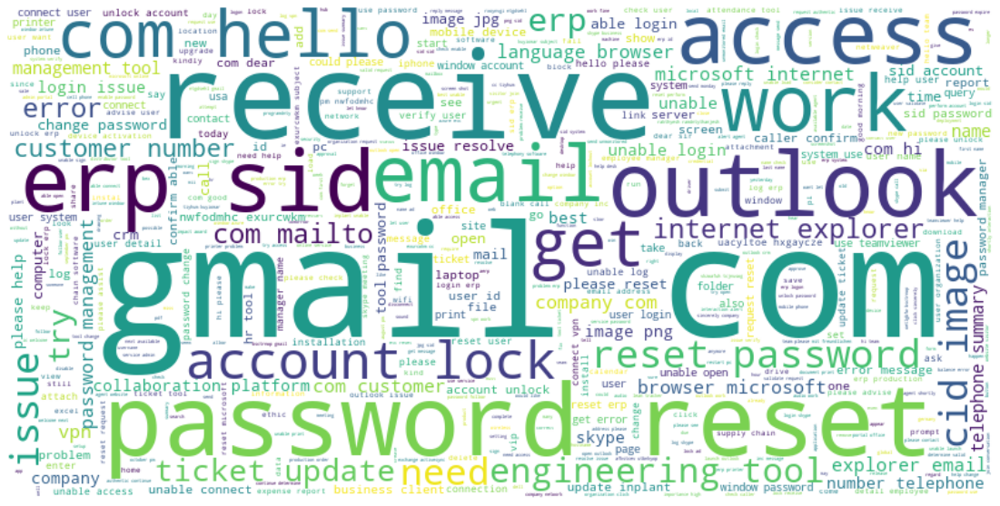

In [149]:
# Draw wordcloud for grp_0 which is largest group

#word cloud for top 3 groups data
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
#word cloud for overall data
stopwords = STOPWORDS

tickets_grp0 = tickets_english[tickets_english['Assignment group'] == 'GRP_0']
wordcloud_grp0 = WordCloud(stopwords = stop_words, max_words=500, background_color="white",width=800, height=400).generate(get_bag_of_words(tickets_grp0['wdnet_lemm'].values))

plt.figure( figsize=(20,10) )
plt.imshow(wordcloud_grp0,interpolation='bilinear')
plt.axis("off")
plt.show()

In [150]:
# From word cloud seems like most prominent issue for Group 0 is resolving email access issues through password reset, etc. 

In [151]:
# Show word cloud for all selected groups
tickets_english['Assignment group'].unique()

array(['GRP_0', 'GRP_3', 'GRP_4', 'GRP_5', 'GRP_6', 'GRP_7', 'GRP_8',
       'GRP_9', 'GRP_10', 'GRP_12', 'GRP_13', 'GRP_14', 'GRP_15',
       'GRP_16', 'GRP_17', 'GRP_18', 'GRP_19', 'GRP_2', 'GRP_20',
       'GRP_24', 'GRP_25', 'GRP_26', 'GRP_28', 'GRP_29', 'GRP_30',
       'GRP_31', 'GRP_34', 'GRP_33', 'GRP_40', 'GRP_41', 'GRP_45',
       'GRP_42'], dtype=object)

Group Name:GRP_0


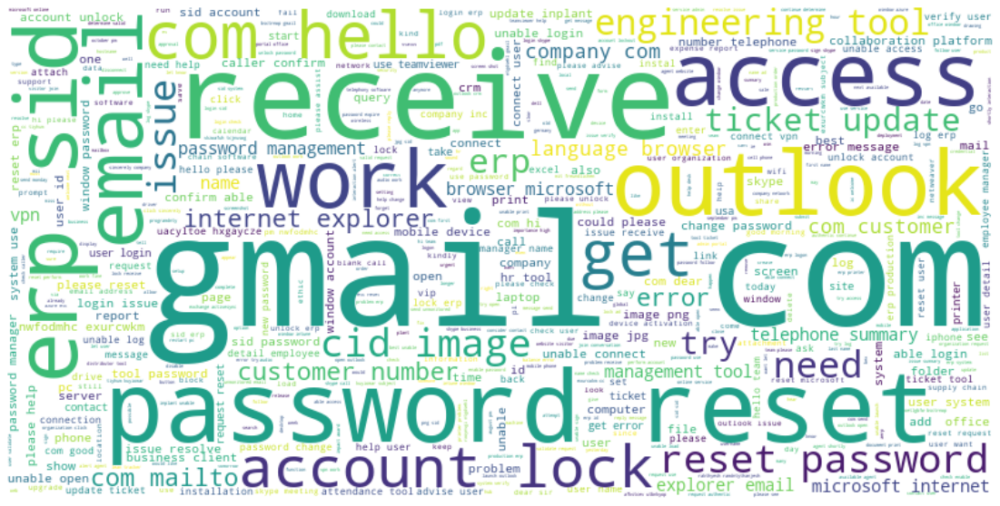

Group Name:GRP_3


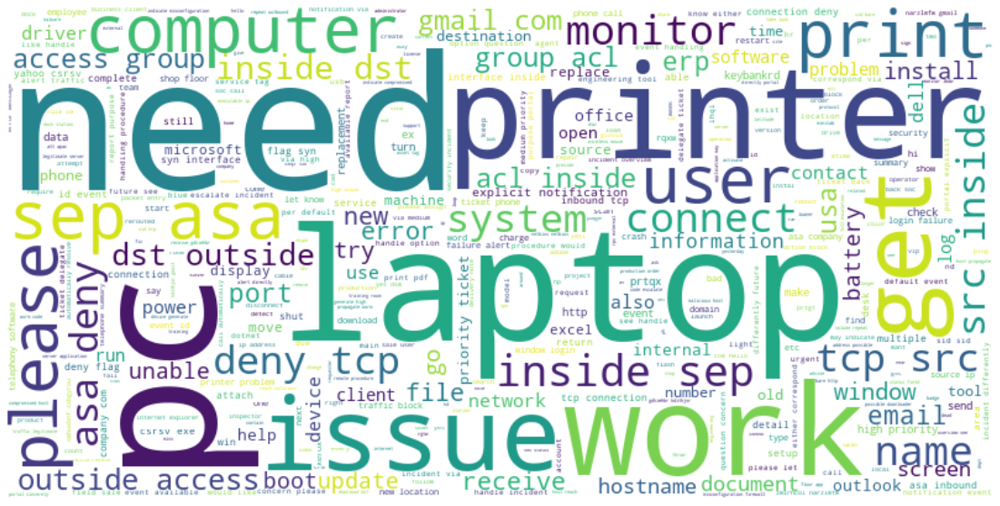

Group Name:GRP_4


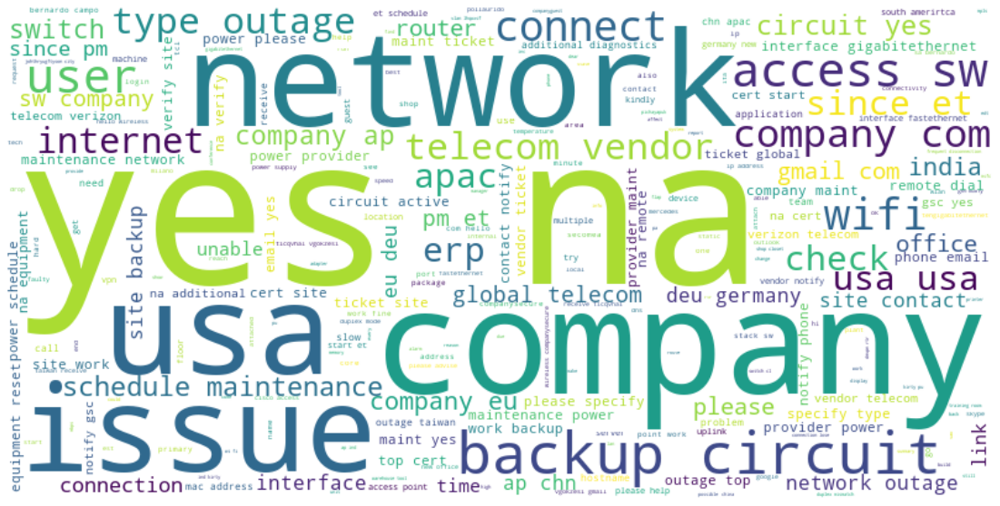

Group Name:GRP_5


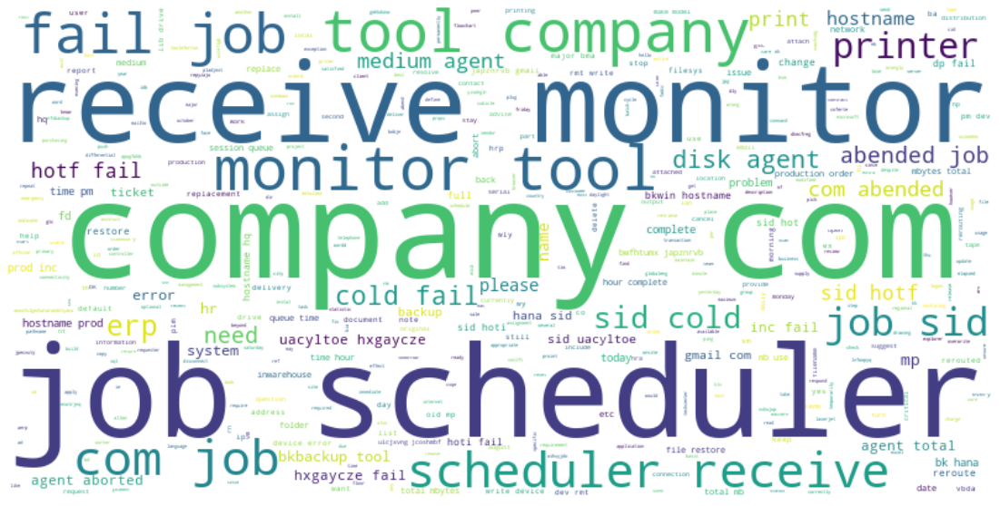

Group Name:GRP_6


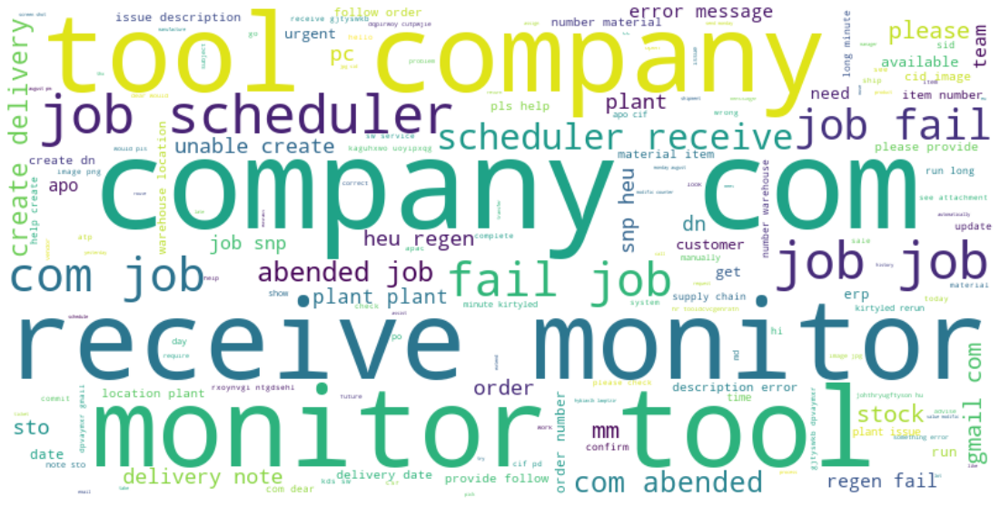

Group Name:GRP_7


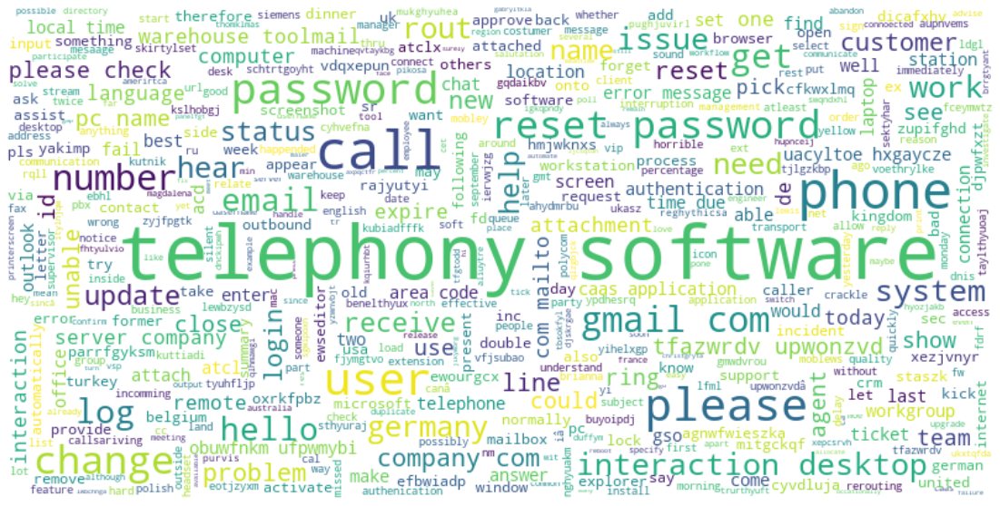

Group Name:GRP_8


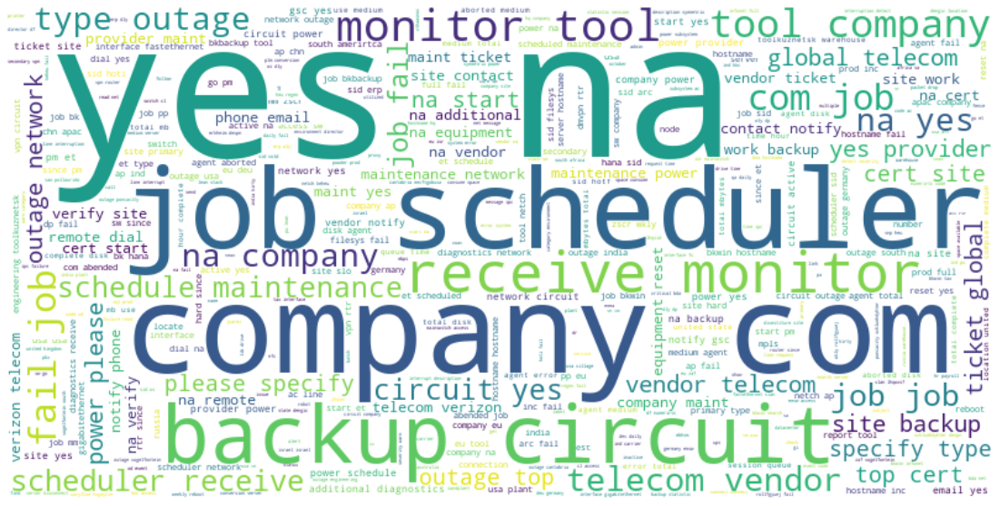

Group Name:GRP_9


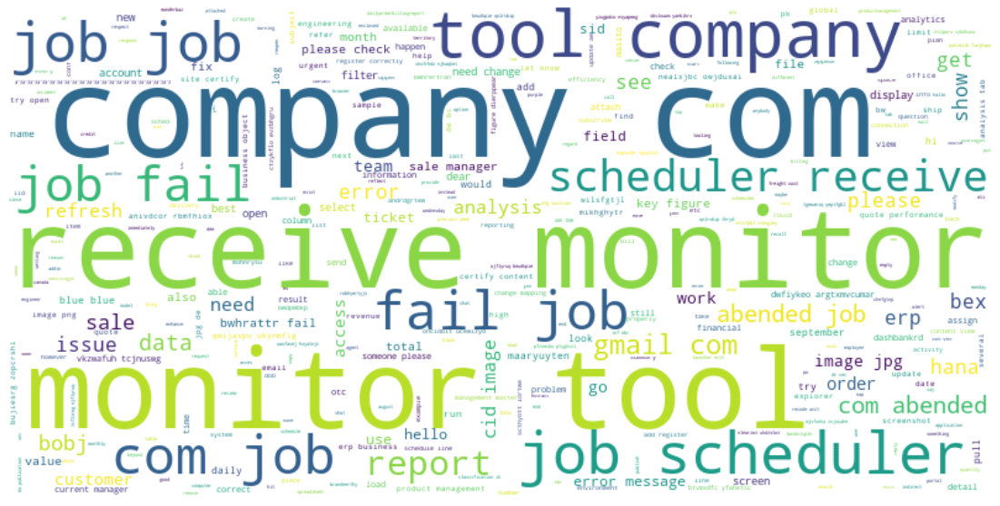

Group Name:GRP_10


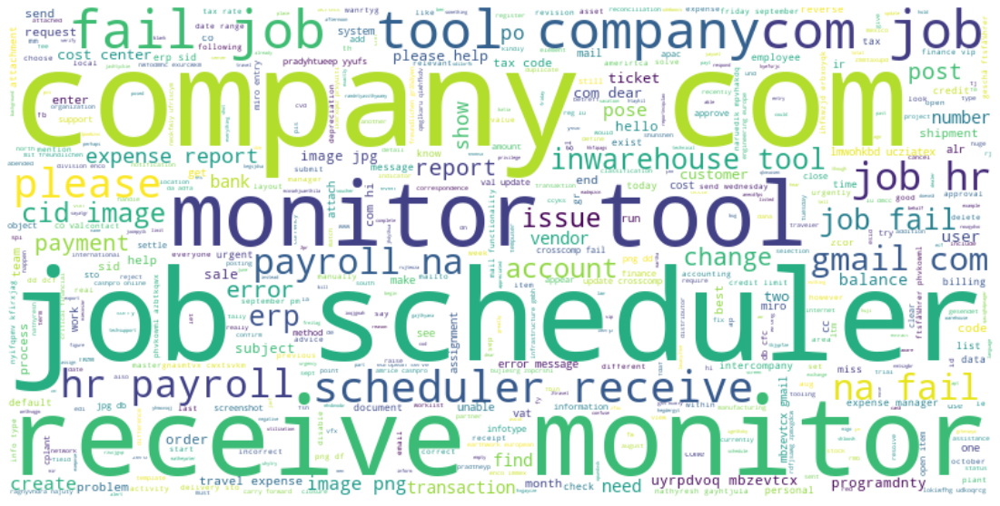

Group Name:GRP_12


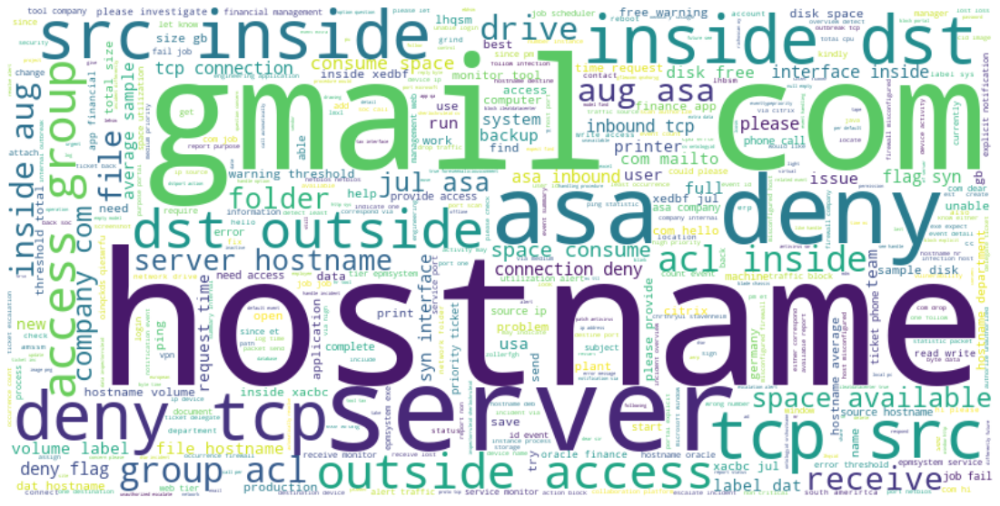

Group Name:GRP_13


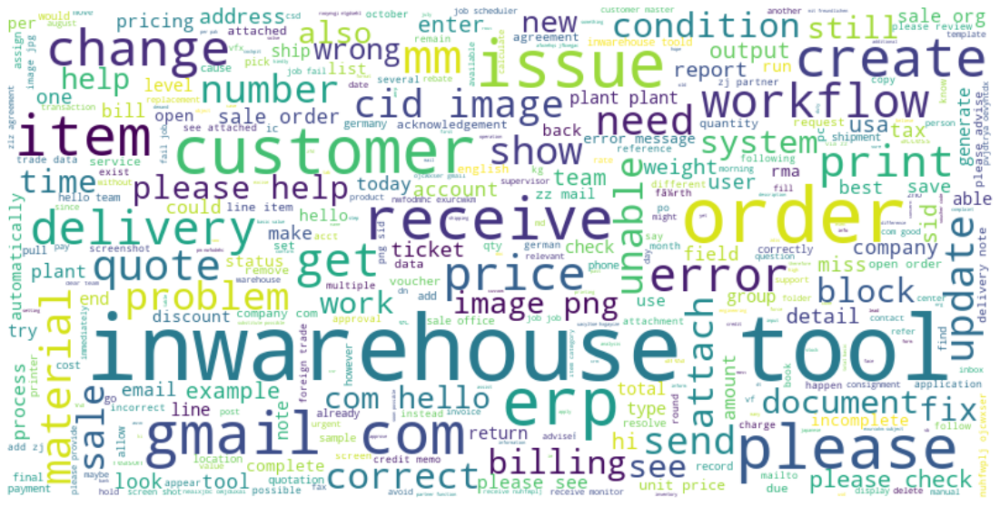

Group Name:GRP_14


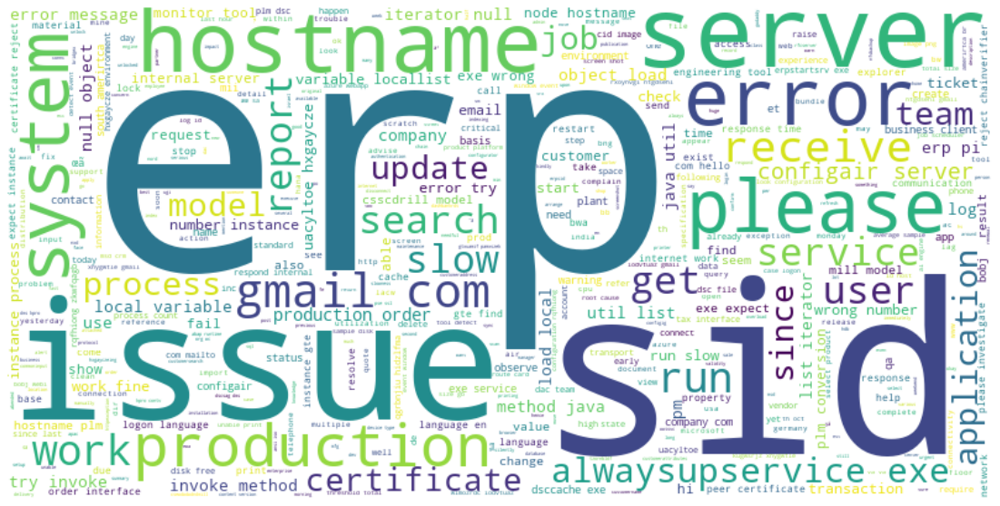

Group Name:GRP_15


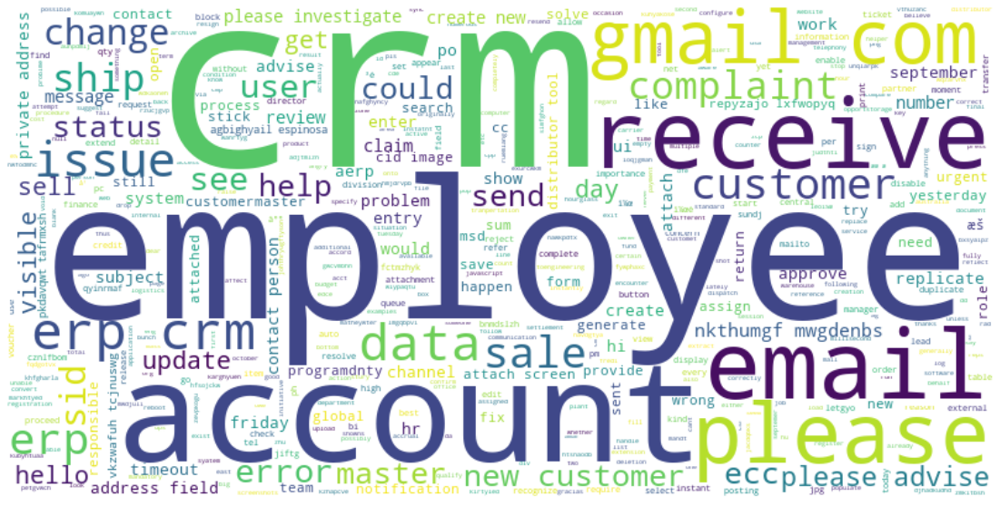

Group Name:GRP_16


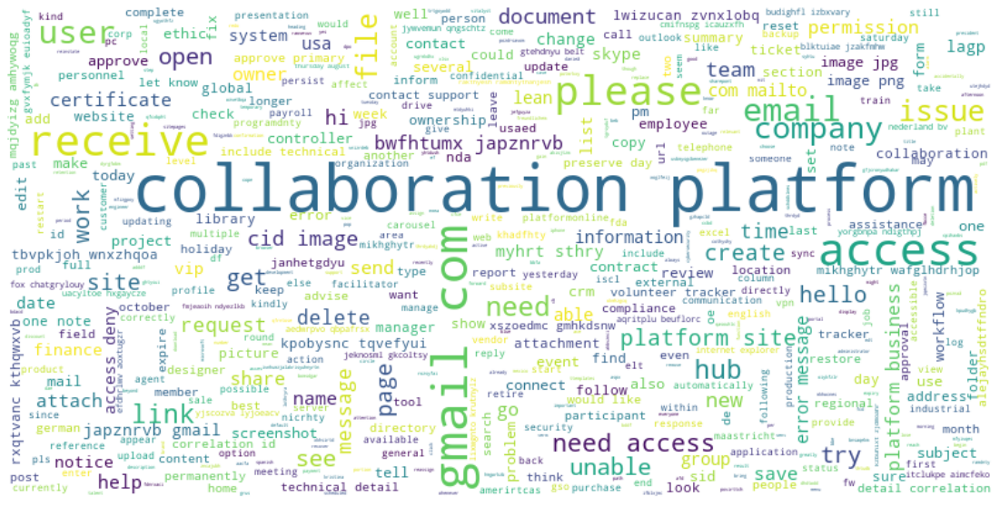

Group Name:GRP_17


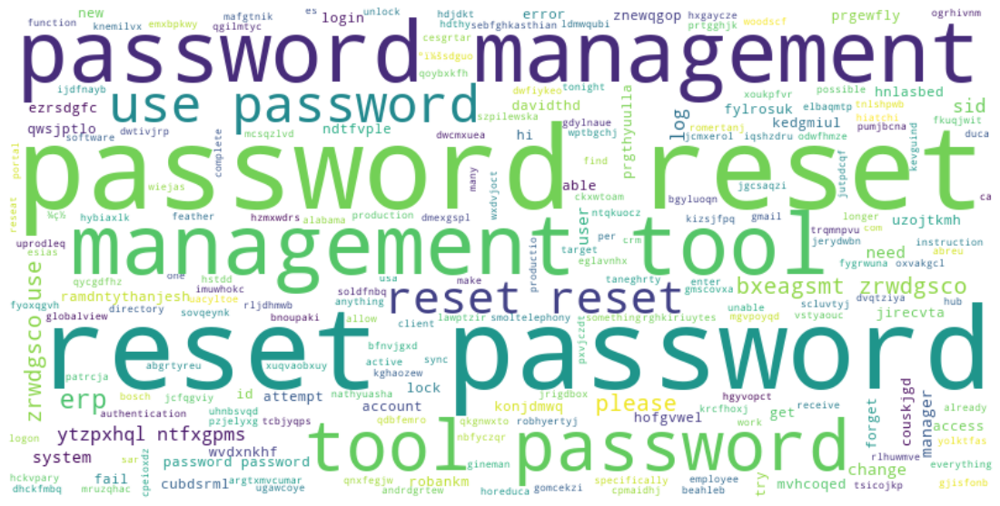

Group Name:GRP_18


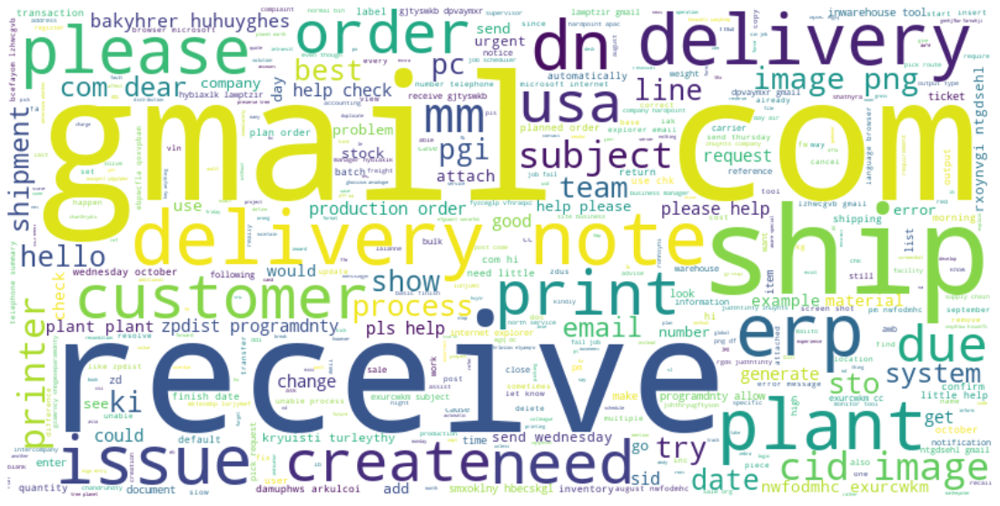

Group Name:GRP_19


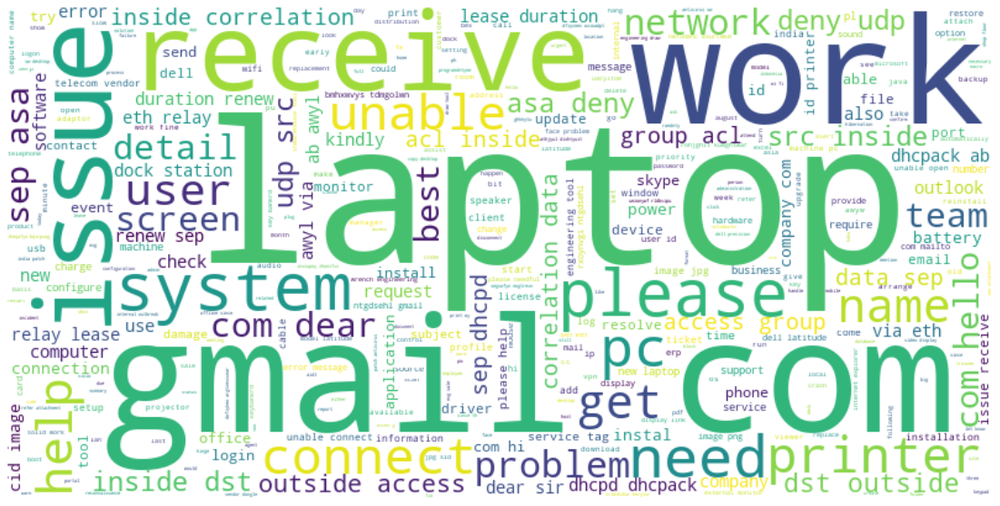

Group Name:GRP_2


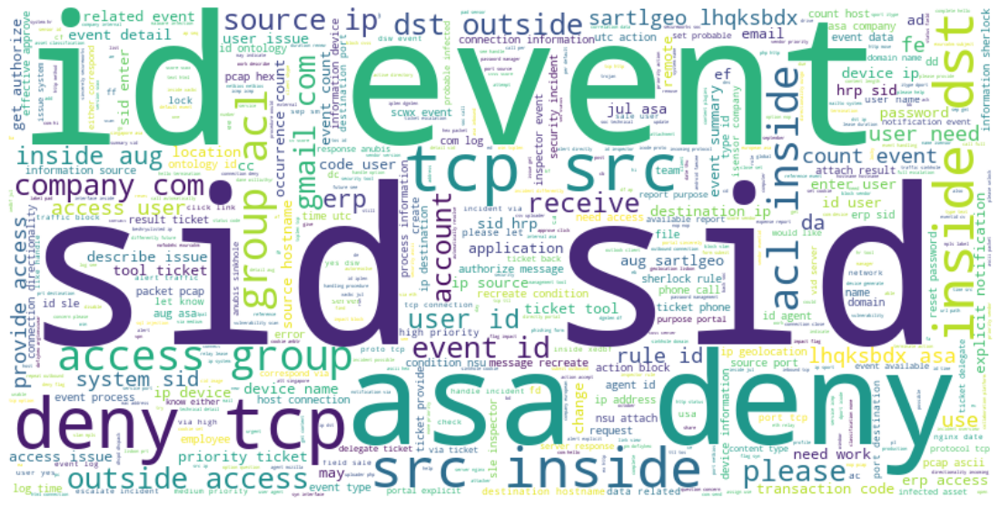

Group Name:GRP_20


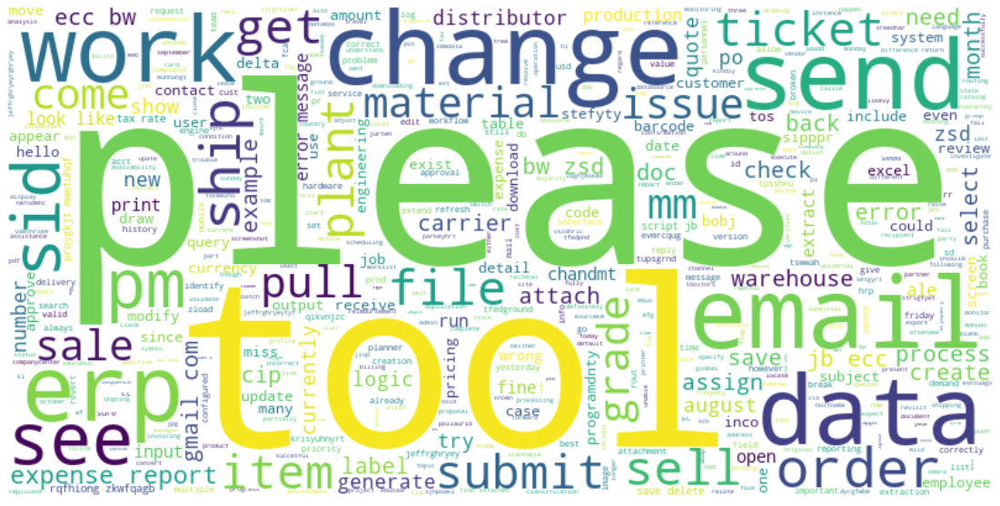

Group Name:GRP_24


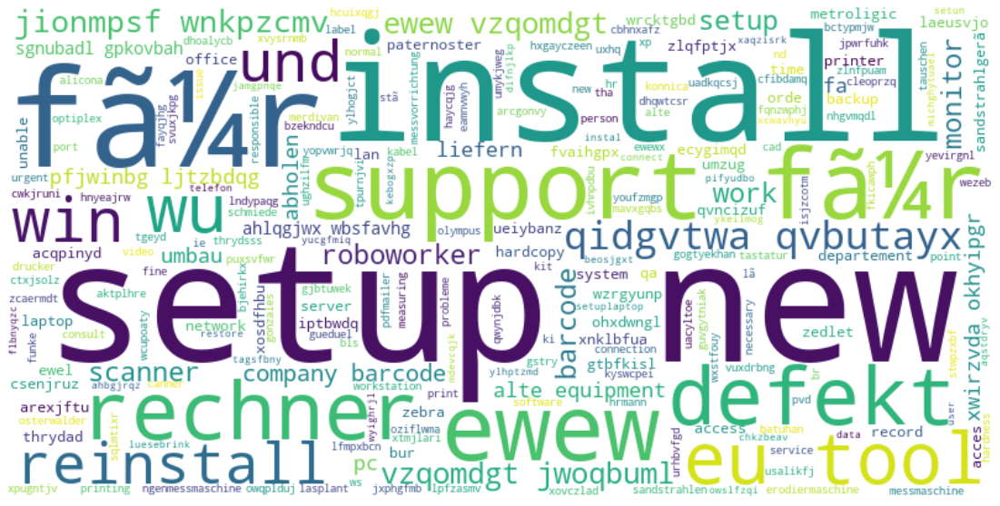

Group Name:GRP_25


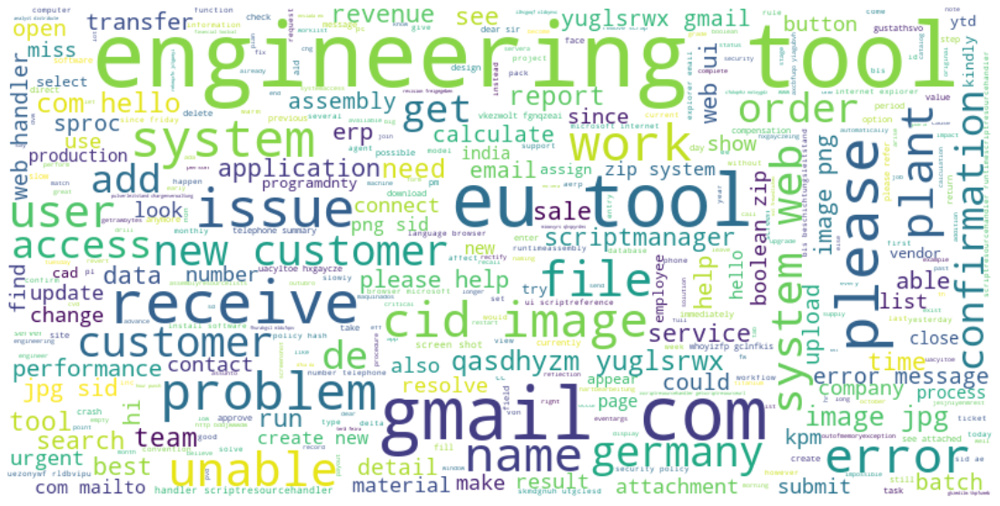

Group Name:GRP_26


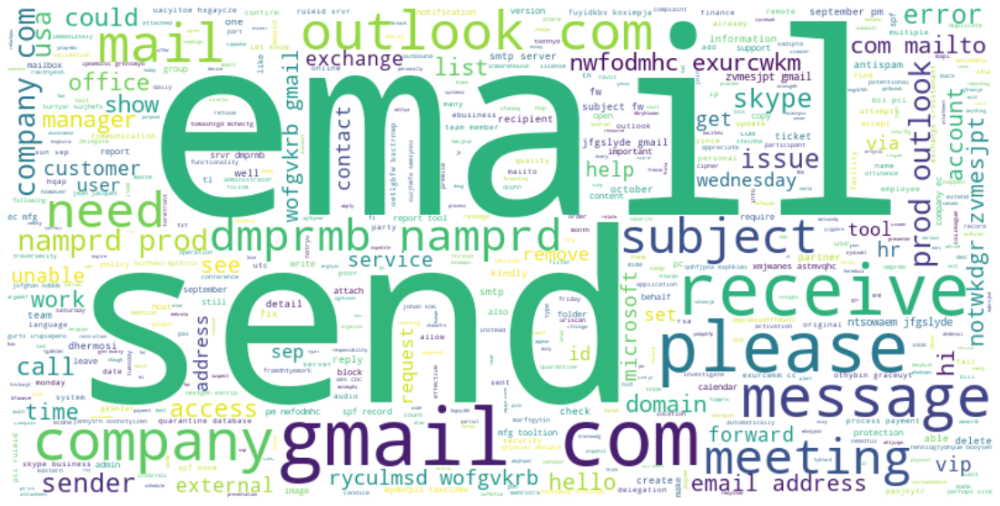

Group Name:GRP_28


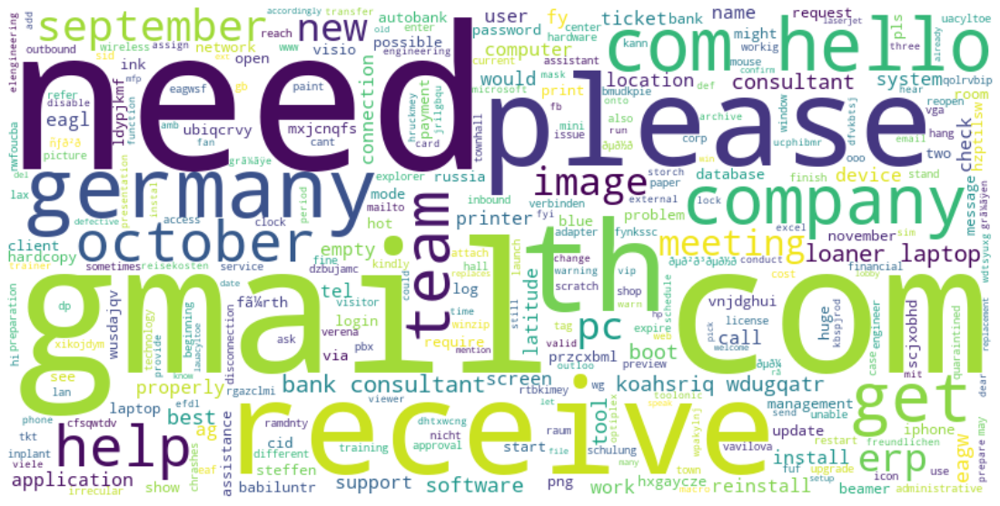

Group Name:GRP_29


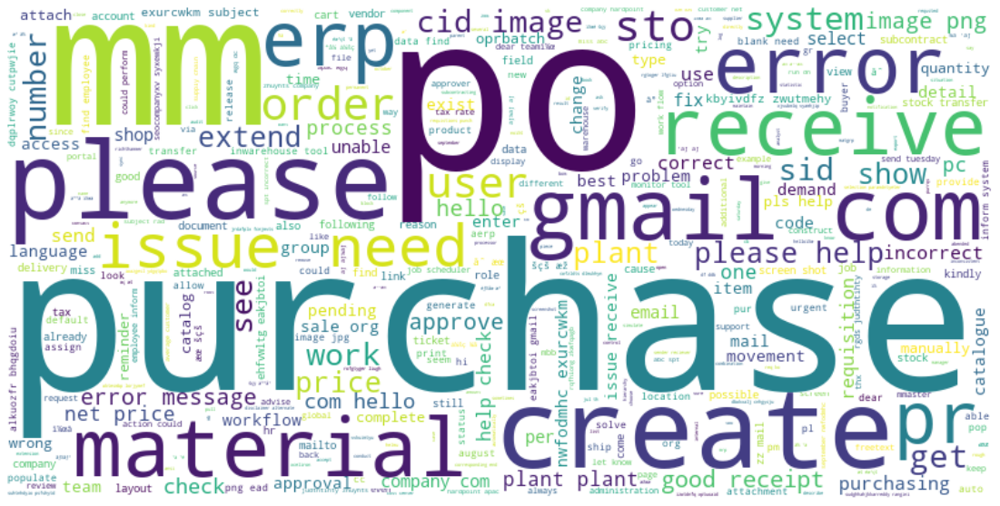

Group Name:GRP_30


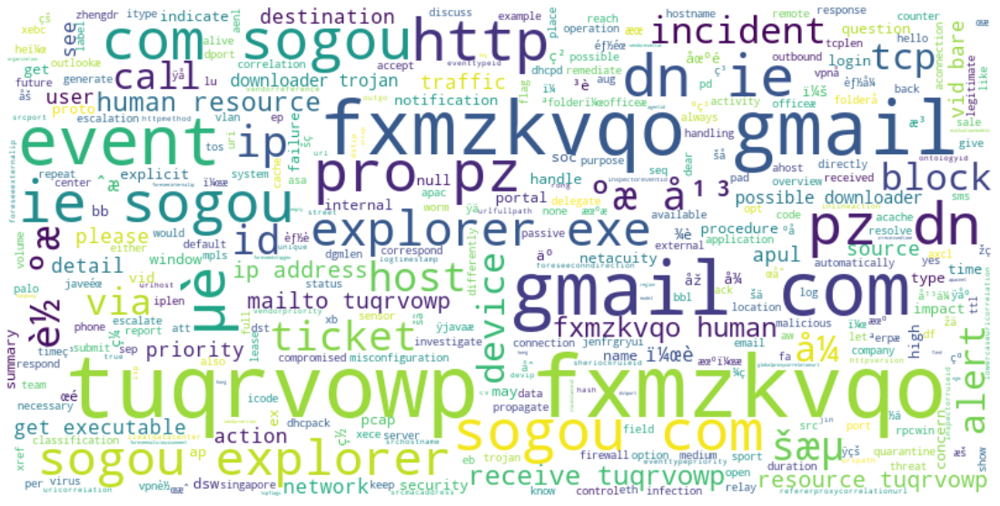

Group Name:GRP_31


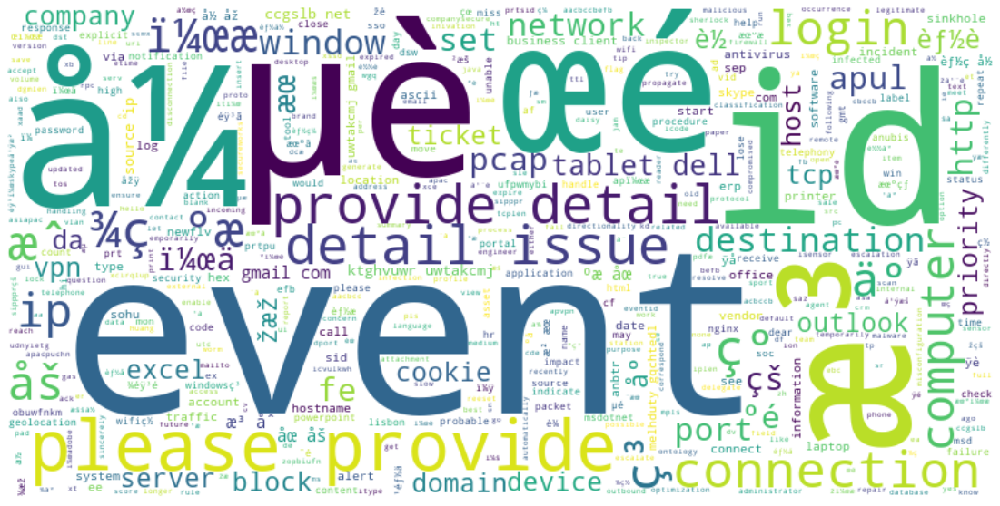

Group Name:GRP_34


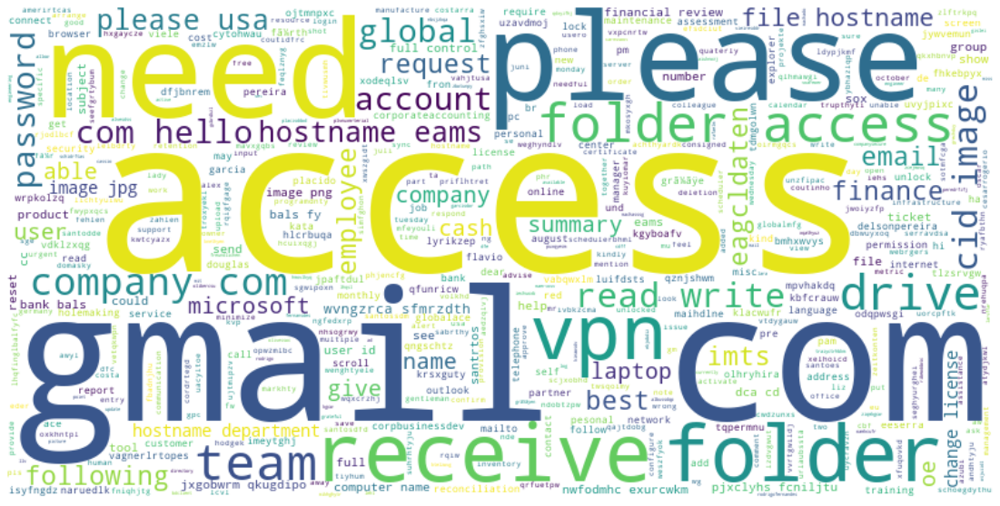

Group Name:GRP_33


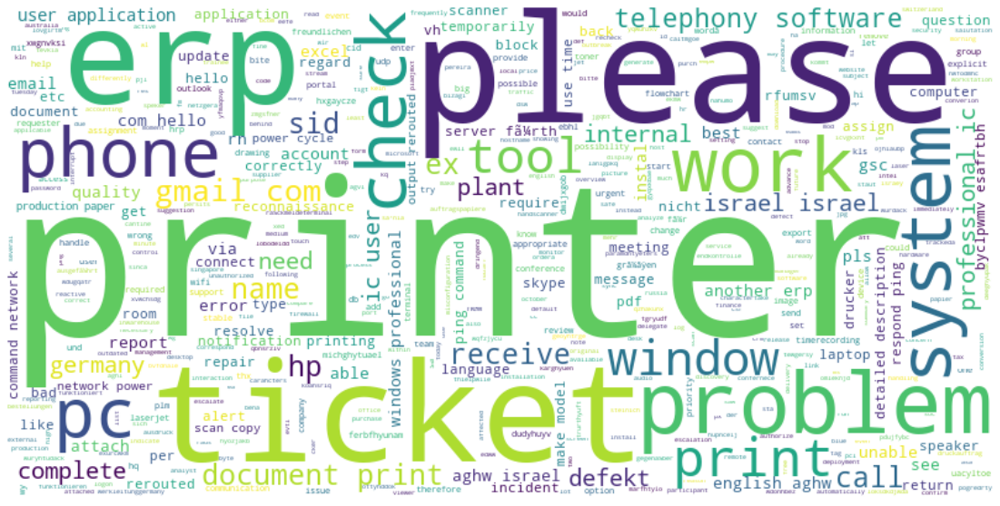

Group Name:GRP_40


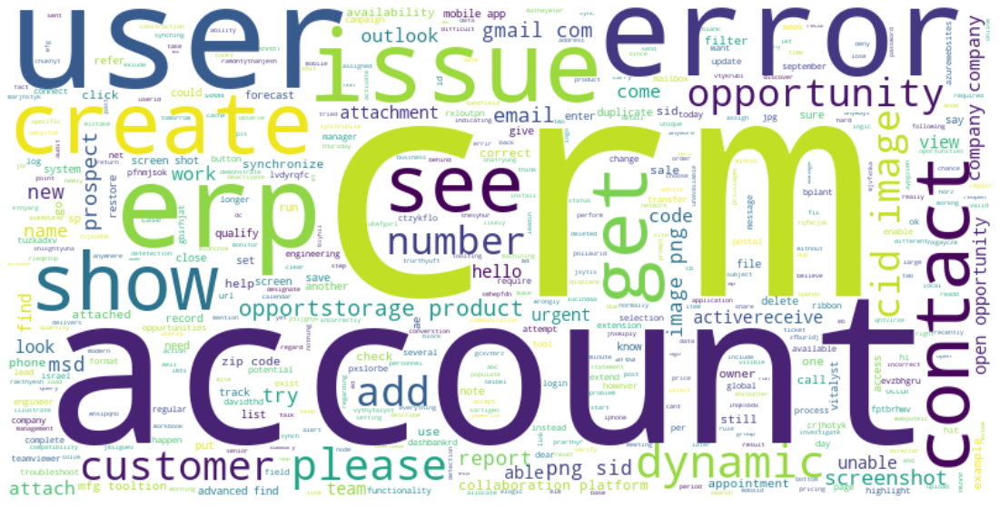

Group Name:GRP_41


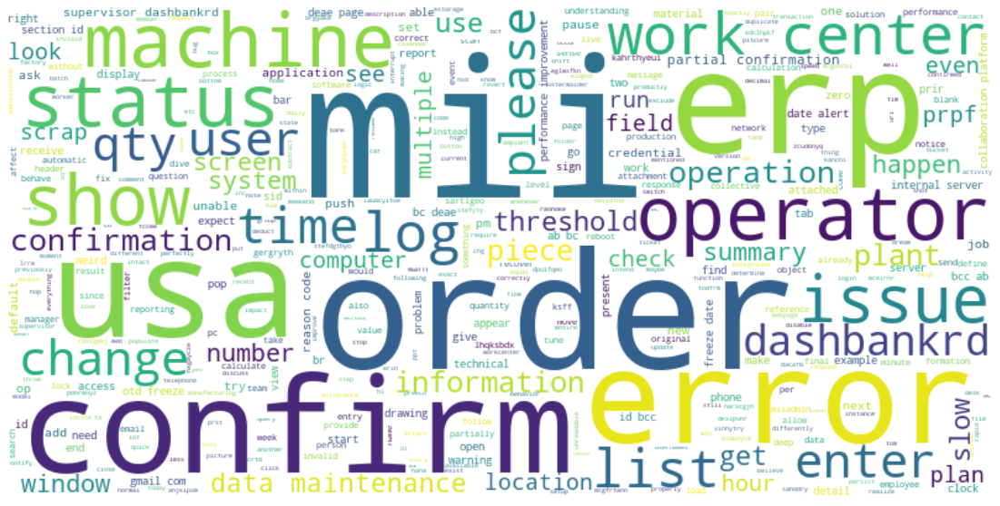

Group Name:GRP_45


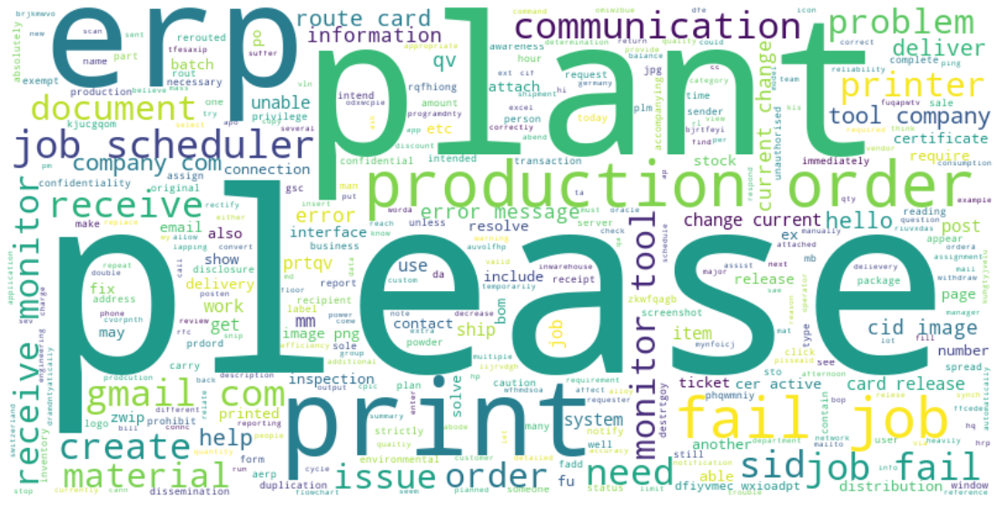

Group Name:GRP_42


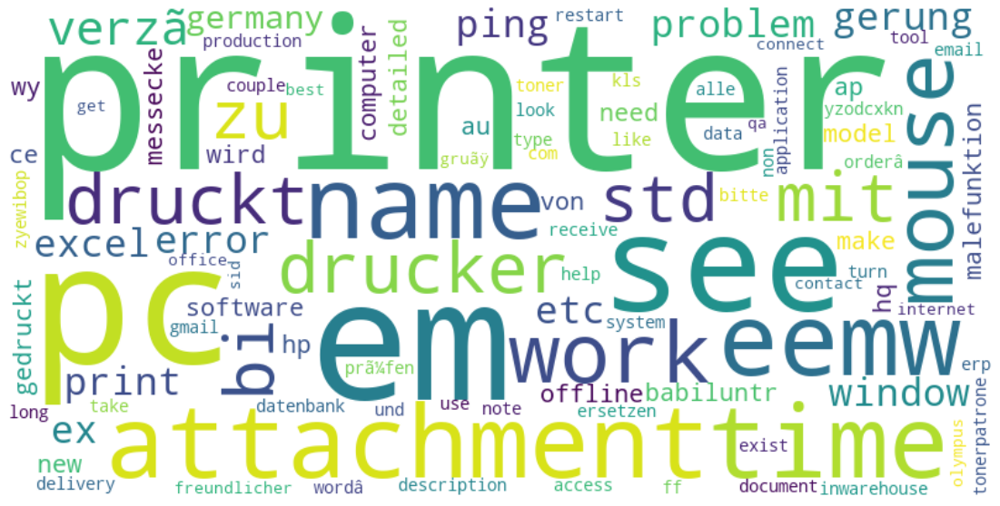

In [153]:
for grp in tickets_english['Assignment group'].unique():
  tickets_grp = tickets_english[tickets_english['Assignment group'] == grp]
  wordcloud_grp = WordCloud(stopwords = stop_words, max_words=500, background_color="white",width=800, height=400).generate(get_bag_of_words(tickets_grp['wdnet_lemm'].values))
  print("Group Name:" + grp)
  plt.figure( figsize=(20,10) )
  plt.imshow(wordcloud_grp,interpolation='bilinear')
  plt.axis("off")
  plt.show()

In [154]:
# Recreate sentences from token from wordnet
def tok_2_sentence(tokens):
  sentence = ""
  for token in tokens: 
    sentence = sentence + " "+ token;
  return sentence

tickets_english['wdnet_Description'] = tickets_english['wdnet_lemm'].apply(lambda v: tok_2_sentence(v))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [155]:
tickets_english

,Description,Assignment group,tokens,stemmed,tokens_pos,wdnet_lemm,wdnet_Description
0,verified user details employee manager name ch...,GRP_0,"[verified, user, details, employee, manager, n...","[verifi, user, detail, employe, manag, name, c...","[(verified, VBN), (user, NN), (details, NNS), ...","[verify, user, detail, employee, manager, name...",verify user detail employee manager name chec...
1,received from hmjdrvpb komuaywn gmail com hell...,GRP_0,"[received, from, hmjdrvpb, komuaywn, gmail, co...","[receiv, from, hmjdrvpb, komuaywn, gmail, com,...","[(received, VBN), (from, IN), (hmjdrvpb, JJ), ...","[receive, from, hmjdrvpb, komuaywn, gmail, com...",receive from hmjdrvpb komuaywn gmail com hell...
2,cant log in to vpn received from eylqgodm ybqk...,GRP_0,"[cant, log, in, to, vpn, received, from, eylqg...","[cant, log, in, to, vpn, receiv, from, eylqgod...","[(cant, JJ), (log, NN), (in, IN), (to, TO), (v...","[cant, log, in, to, vpn, receive, from, eylqgo...",cant log in to vpn receive from eylqgodm ybqk...
3,unable to access hr tool page,GRP_0,"[unable, to, access, hr, tool, page]","[unabl, to, access, hr, tool, page]","[(unable, JJ), (to, TO), (access, NN), (hr, NN...","[unable, to, access, hr, tool, page]",unable to access hr tool page
5,unable to log in to engineering tool and skype,GRP_0,"[unable, to, log, in, to, engineering, tool, a...","[unabl, to, log, in, to, engin, tool, and, skype]","[(unable, JJ), (to, TO), (log, VB), (in, IN), ...","[unable, to, log, in, to, engineering, tool, a...",unable to log in to engineering tool and skype
...,...,...,...,...,...,...,...
8493,erp fi ob two accounts to be added i am sorry ...,GRP_10,"[erp, fi, ob, two, accounts, to, be, added, i,...","[erp, fi, ob, two, account, to, be, ad, i, am,...","[(erp, NN), (fi, NNS), (ob, VBP), (two, CD), (...","[erp, fi, ob, two, account, to, be, add, i, be...",erp fi ob two account to be add i be sorry i ...
8494,tablet needs reimaged due to multiple issues w...,GRP_3,"[tablet, needs, reimaged, due, to, multiple, i...","[tablet, need, reimag, due, to, multipl, issu,...","[(tablet, NN), (needs, NNS), (reimaged, VBD), ...","[tablet, need, reimaged, due, to, multiple, is...",tablet need reimaged due to multiple issue wi...
8495,emails not coming in from zz mail received fro...,GRP_29,"[emails, not, coming, in, from, zz, mail, rece...","[email, not, come, in, from, zz, mail, receiv,...","[(emails, NNS), (not, RB), (coming, VBG), (in,...","[email, not, come, in, from, zz, mail, receive...",email not come in from zz mail receive from a...
8496,telephony software issue,GRP_0,"[telephony, software, issue]","[telephoni, softwar, issu]","[(telephony, NN), (software, NN), (issue, NN)]","[telephony, software, issue]",telephony software issue


In [156]:
# TFID vectorizer as recommended during mentoring session
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer()
tickets_tfidf = vectorizer.fit_transform(tickets_english['wdnet_Description'])
print(tickets_tfidf.shape)

(7430, 12042)


In [160]:
vectorizer.get_feature_names()

['aa',
 'aaa',
 'aab',
 'aacbcc',
 'aacbccbefb',
 'aacfa',
 'aacount',
 'aad',
 'aadb',
 'aae',
 'aaefe',
 'aao',
 'aaplant',
 'ab',
 'abandon',
 'abap',
 'abb',
 'abba',
 'abbc',
 'abc',
 'abca',
 'abcdegy',
 'abcdri',
 'abd',
 'abdhtyu',
 'abe',
 'abend',
 'abended',
 'abeoucfj',
 'abf',
 'abff',
 'abgebildet',
 'abgrtyreu',
 'abhay',
 'abholen',
 'ability',
 'abl',
 'able',
 'abode',
 'abort',
 'aborted',
 'about',
 'above',
 'abovementioned',
 'abreu',
 'abrurto',
 'absence',
 'absent',
 'absolutely',
 'abwfnzwbnvbw',
 'ac',
 'acache',
 'acb',
 'acbccb',
 'acc',
 'acccount',
 'accdb',
 'accees',
 'accept',
 'acceptance',
 'acceptingâ',
 'acces',
 'accesible',
 'acceso',
 'access',
 'accessibility',
 'accessible',
 'accident',
 'accidental',
 'accidentally',
 'accidently',
 'accompanying',
 'accomplish',
 'accont',
 'accord',
 'accordance',
 'accordingly',
 'accound',
 'account',
 'accountant',
 'accounting',
 'accout',
 'accross',
 'accrual',
 'accsess',
 'acct',
 'accts',
 'accura